# Approach #x - template for presenting one approach

## Description

* describe the approach, technique, cite all the sources
* why was this method chosen, what do we expect to gain as explanations etc.
* ...
* ...
* ...
* ...
* ...
* ...


## Categorization of the approach

* answer all Hohman et al. questions (WHY, WHO, WHAT, HOW, WHEN, and WHERE): https://fredhohman.com/visual-analytics-in-deep-learning/
* ...
* ...
* ...
* ...
* ...
* ...

## Experiments with YOLOv8n for classification and selected samples

**TODO**: Implement/reproduce the selected explainability approaches and apply them to the model you chose. Using existing code from the Internet is allowed, but you need to be able to explain the approaches and adapt them to your model/problem.

In [ ]:
import ultralytics
from ultralytics import YOLO
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt
import requests
import torchvision.transforms as transforms
from PIL import Image
import io
import glob
import sys
sys.path.append("resources/")
from eigenCam import show_eigen_cam


In [ ]:
plt.rcParams["figure.figsize"] = [3.0, 3.0]

In [ ]:
model = YOLO('models/yolov8n-cls.pt')

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████| 5.28M/5.28M [00:00<00:00, 25.9MB/s]


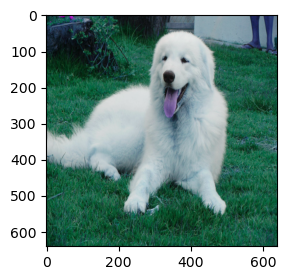

In [ ]:
img = cv2.imread('images/val/222/ILSVRC2012_val_00001484.JPEG')
img = cv2.resize(img, (640, 640))
rgb_img = img.copy()
img = np.float32(img) / 255
plt.imshow(img)

In [ ]:
results = model('images/val/222/ILSVRC2012_val_00001484.JPEG')

for res in results:
    top_class = torch.argmax(res.probs.data)
    print("TOP CLASS:", res.names[top_class.item()])


image 1/1 /Users/jozsi/PycharmProjects/assignment-2-model-explanations-awkward-pigeons/images/val/222/ILSVRC2012_val_00001484.JPEG: 224x224 Great_Pyrenees 0.69, kuvasz 0.18, Samoyed 0.11, golden_retriever 0.01, standard_poodle 0.00, 11.9ms
Speed: 1.2ms preprocess, 11.9ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
TOP CLASS: Great_Pyrenees


## Interpretation of the results

Interpret the results of your explainability approach and describe how they help to explain your model and/or how it makes decisions.

* ...
* ...
* ...
* ...
* ...
* ...
* ...

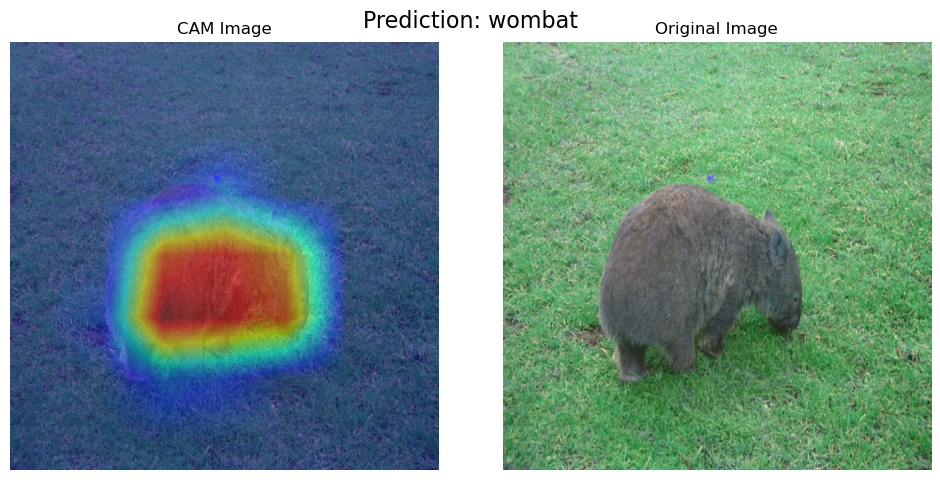

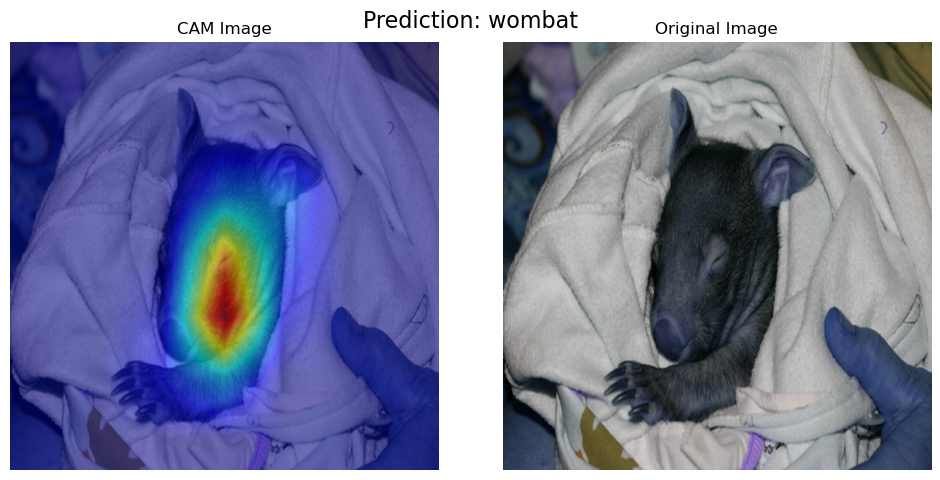

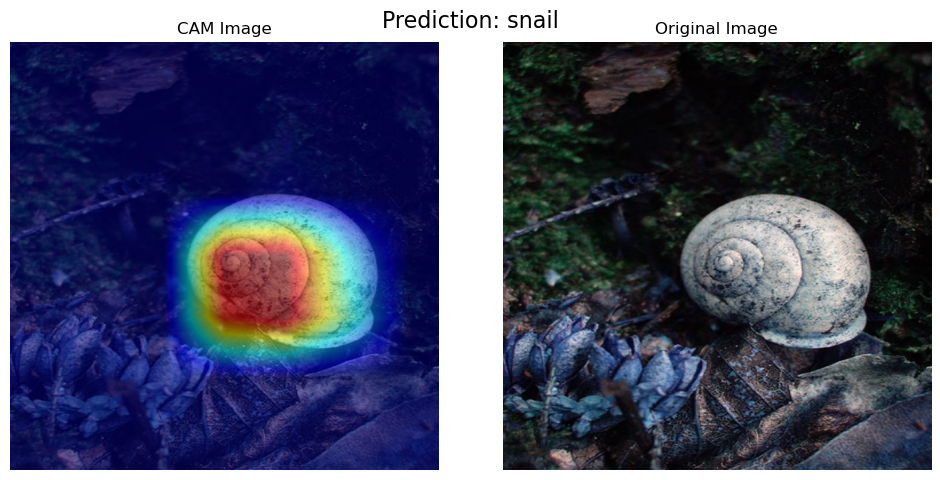

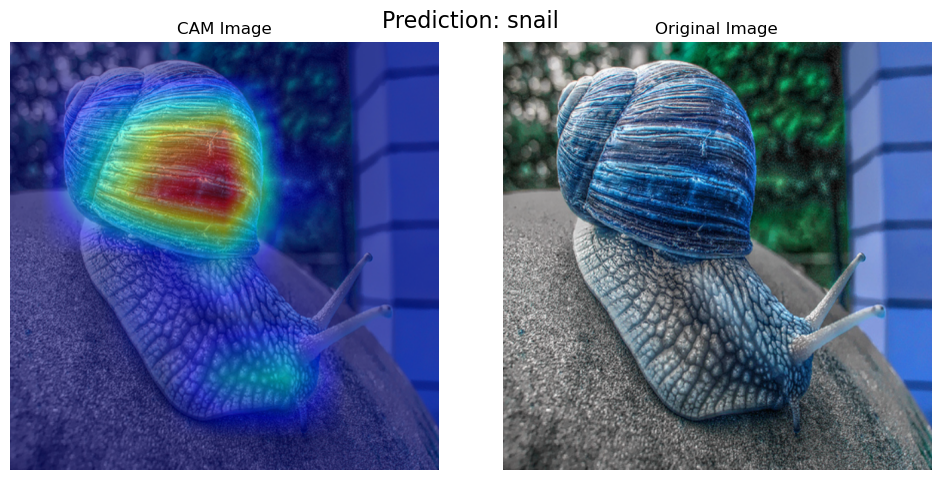

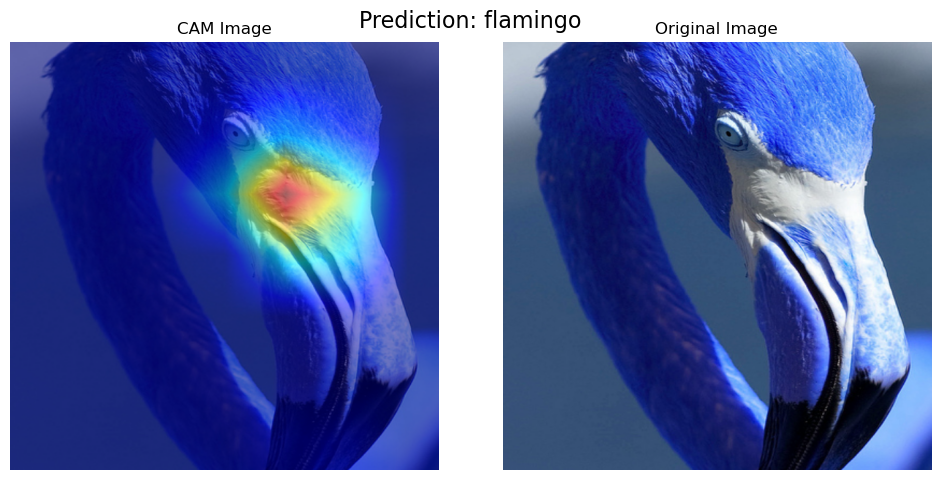

...

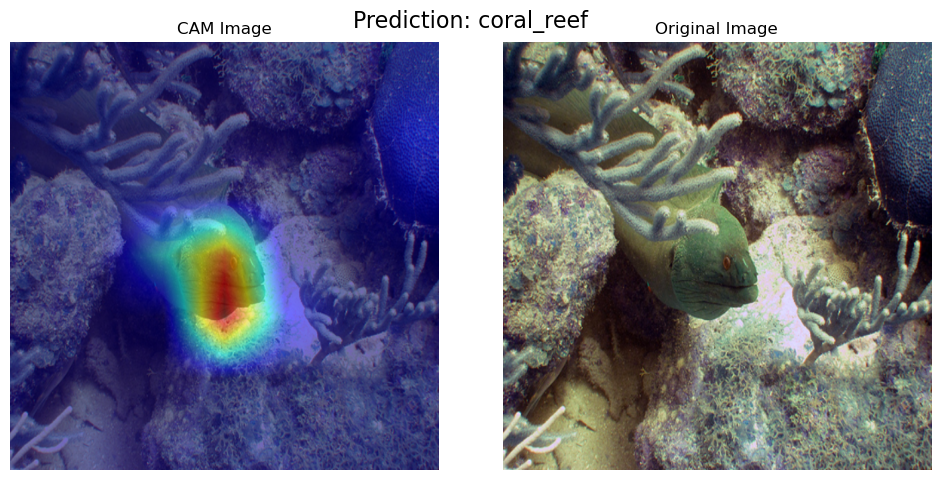

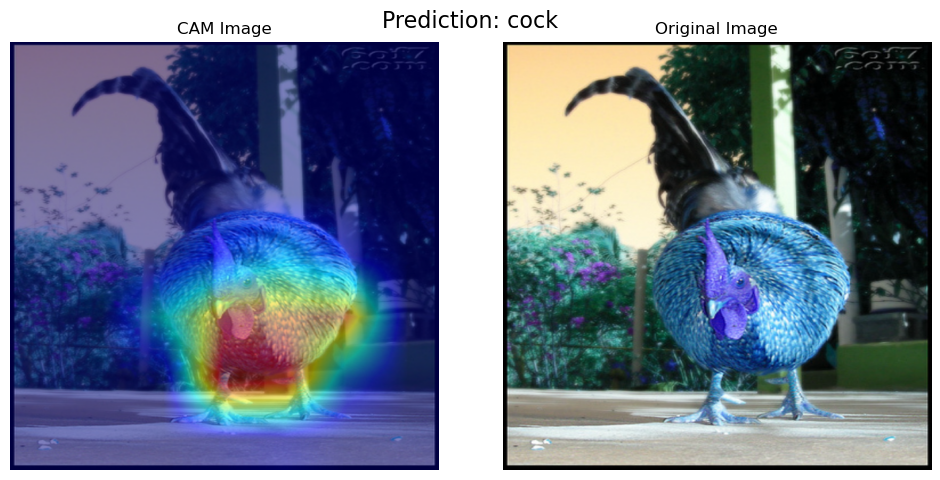

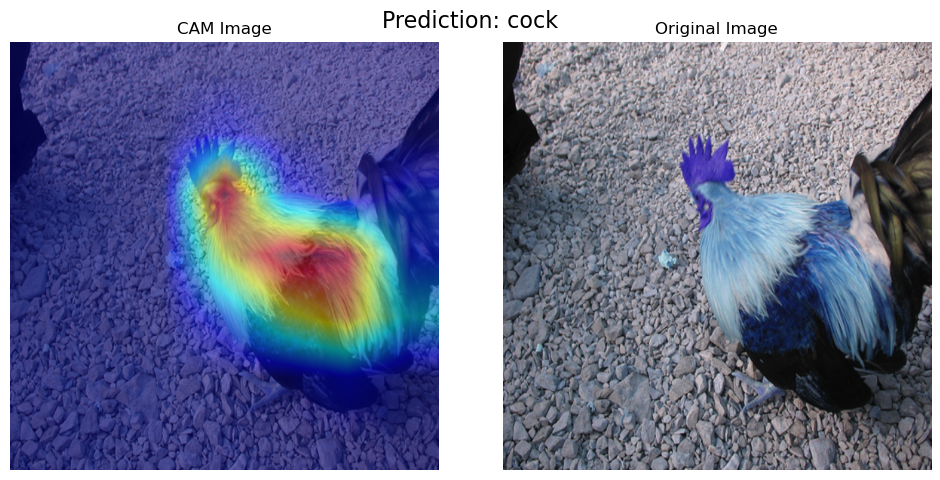

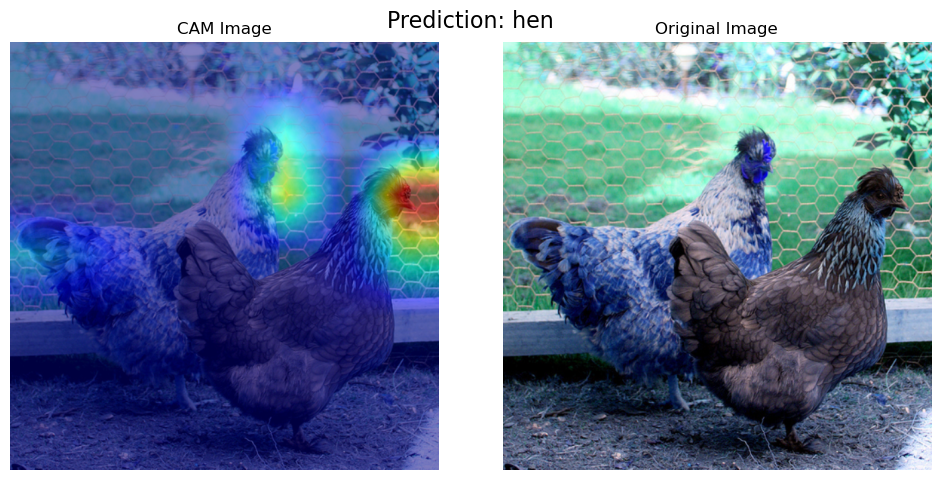

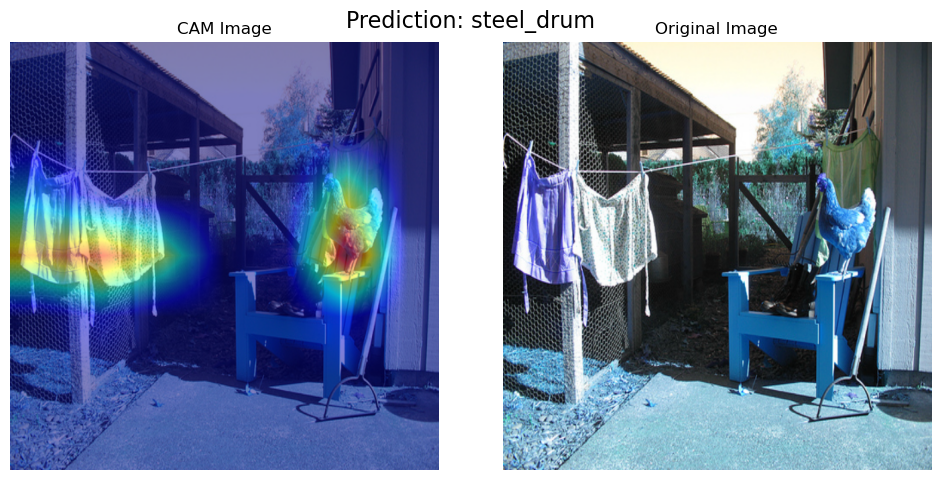

In [ ]:
images = glob.glob("images/val/*/*.JPEG")
model = YOLO('models/yolov8n-cls.pt')
for image in images:
    show_eigen_cam(model,image)

#Activation Maximization

## Description

Activation maximization is a technique that helps us visualize how certain input patterns can make neurons, in neural networks more active. This method generates images that strongly stimulate the model by modifying the input image to maximize the activation of a chosen neuron. The reason for selecting this method is because its user friendly and effective in identifying the characteristics of an input image that trigger network activations. It allows us to better understand the patterns or features that the model focuses on when making classifications providing insights, into its decision making process. This technique has been widely used in interpretability research. Is referenced in studies exploring neural network behavior.

In our task, we examined 40 images, we split it in two classes, 20 images from the "Simpler Sample" and 20 images to "More Challenging" classes, all depicting various animals. We used YOLOv8n model, we conducted analyses with Activation Maximization method, revealing distinct images for each class. The comparison showcases original images alongside their corresponding Activation Maximization outputs, demonstrating alterations in color and visual features, highlighting the model's focus on animal-centric distinctions.

## Categorization of the approach

* WHY: Activation Maximization can creates images, that activate maximally some of the neurons or classes and it show the working of the deep neural networks. It also help to understand whic features and pattern can the network recognise.

* WHO: Deep Learning specialists or developers or researchers can use the activation maximization to understand better how the neural networks recognize and how can take a differentiation about features within their learnt representations.

* WHAT: Activation Maximization is method, which can help us to understand better the decision making process, beside it can show what is the patterns or features within the input activate specific neurons or classes in a neural network, which reveal us what is like the decision-making process.

* HOW: It iteraratively modify the input image to reach the activation maximisation of the selected neuron or class, because it optimise the image to cause strong responses from the targeted parts of the neuron.

* WHEN: Use it during model development or debugging or interpretability analysis to better understand neural network behavior, especially when transparency or comprehensibility is essential.

* WHERE: It can be applied in the field of the Deep learning research, it helps us in the analysis and understanding of learned representations, especially where we want to understand the inner workings of neural networks.

##Experiments with Activation Maximization using YOLOv8n for classification and selected samples

In [ ]:
!pip install ultralytics

In [ ]:
!pip install ttach

In [3]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import torchvision.transforms as transforms
from ultralytics import YOLO
from torch import optim
from torch.optim.lr_scheduler import StepLR
from PIL import Image
import os

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
# Load the YOLO model
model = YOLO('/content/drive/MyDrive/Colab/YOLO/yolo_cam/yolov8n-cls.pt')
model.eval()

Ultralytics YOLOv8.0.227 🚀 Python-3.10.12 torch-2.1.0+cu118 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=classify, mode=train, model=/content/drive/MyDrive/Colab/YOLO/yolo_cam/yolov8n-cls.pt, data=imagenet10, epochs=100, patience=50, batch=16, imgsz=224, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True,

100%|██████████| 71.1k/71.1k [00:00<00:00, 2.84MB/s]
Unzipping /content/datasets/imagenet10.zip to /content/datasets/imagenet10...: 100%|██████████| 24/24 [00:00<00:00, 685.42file/s]

Dataset download success ✅ (1.2s), saved to /content/datasets/imagenet10

train: /content/datasets/imagenet10/train... found 12 images in 10 classes ✅ 
val: /content/datasets/imagenet10/val... found 12 images in 10 classes ✅ 
test: None...


Overriding model.yaml nc=1000 with nc=10

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralyt

train: Scanning /content/datasets/imagenet10/train... 12 images, 0 corrupt: 100%|██████████| 12/12 [00:00<00:00, 401.38it/s]

train: New cache created: /content/datasets/imagenet10/train.cache


albumentations: RandomResizedCrop(p=1.0, height=224, width=224, scale=(0.5, 1.0), ratio=(0.75, 1.3333333333333333), interpolation=1), HorizontalFlip(p=0.5), ColorJitter(p=0.5, brightness=[0.6, 1.4], contrast=[0.6, 1.4], saturation=[0.30000000000000004, 1.7], hue=[-0.015, 0.015]), Normalize(p=1.0, mean=(0.0, 0.0, 0.0), std=(1.0, 1.0, 1.0), max_pixel_value=255.0), ToTensorV2(always_apply=True, p=1.0, transpose_mask=False)


val: Scanning /content/datasets/imagenet10/val... 12 images, 0 corrupt: 100%|██████████| 12/12 [00:00<00:00, 3354.33it/s]

val: New cache created: /content/datasets/imagenet10/val.cache
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 26 weight(decay=0.0), 27 weight(decay=0.0005), 27 bias(decay=0.0)


Image sizes 224 train, 224 val
Using 0 dataloader workers
Logging results to runs/classify/train
Starting training for 100 epochs...

      Epoch    GPU_mem       loss  Instances       Size


      1/100         0G       2.21         12        224: 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.38it/s]

                   all          0        0.5



      Epoch    GPU_mem       loss  Instances       Size


  0%|          | 0/1 [00:00<?, ?it/s]

      2/100         0G      2.278         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.41it/s]

                   all          0        0.5



      Epoch    GPU_mem       loss  Instances       Size


  0%|          | 0/1 [00:00<?, ?it/s]
100%|██████████| 755k/755k [00:00<00:00, 10.1MB/s]
      3/100         0G      2.149         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.67it/s]

                   all      0.167        0.5



      Epoch    GPU_mem       loss  Instances       Size


      4/100         0G      2.217         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.63it/s]


                   all      0.167       0.75

      Epoch    GPU_mem       loss  Instances       Size


      5/100         0G      2.195         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.59it/s]


                   all      0.167       0.75

      Epoch    GPU_mem       loss  Instances       Size


      6/100         0G      2.225         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.65it/s]

                   all      0.167       0.75



      Epoch    GPU_mem       loss  Instances       Size


      7/100         0G      2.164         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.72it/s]

                   all      0.167       0.75



      Epoch    GPU_mem       loss  Instances       Size


      8/100         0G      2.092         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.64it/s]


                   all      0.167       0.75

      Epoch    GPU_mem       loss  Instances       Size


      9/100         0G      2.072         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.46it/s]

                   all      0.167       0.75



      Epoch    GPU_mem       loss  Instances       Size


     10/100         0G      1.975         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.64it/s]


                   all      0.167      0.833

      Epoch    GPU_mem       loss  Instances       Size


     11/100         0G      1.866         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.79it/s]

                   all      0.167      0.833



      Epoch    GPU_mem       loss  Instances       Size


     12/100         0G      1.743         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.93it/s]

                   all      0.167      0.833



      Epoch    GPU_mem       loss  Instances       Size


     13/100         0G      1.715         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.61it/s]

                   all      0.167      0.833



      Epoch    GPU_mem       loss  Instances       Size


     14/100         0G      1.579         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.66it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     15/100         0G      1.476         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.20it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.57it/s]

                   all     0.0833      0.917



      Epoch    GPU_mem       loss  Instances       Size


     16/100         0G       1.49         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.50it/s]


                   all     0.0833      0.917

      Epoch    GPU_mem       loss  Instances       Size


     17/100         0G      1.428         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.60it/s]

                   all     0.0833      0.917



      Epoch    GPU_mem       loss  Instances       Size


     18/100         0G      1.277         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.62it/s]


                   all     0.0833      0.917

      Epoch    GPU_mem       loss  Instances       Size


     19/100         0G      1.267         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.86it/s]

                   all     0.0833      0.917



      Epoch    GPU_mem       loss  Instances       Size


     20/100         0G      1.069         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.72it/s]

                   all     0.0833      0.917



      Epoch    GPU_mem       loss  Instances       Size


     21/100         0G      1.218         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.83it/s]

                   all     0.0833      0.917



      Epoch    GPU_mem       loss  Instances       Size


     22/100         0G      1.123         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.92it/s]

                   all     0.0833      0.917



      Epoch    GPU_mem       loss  Instances       Size


     23/100         0G      1.125         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.70it/s]

                   all      0.333      0.917



      Epoch    GPU_mem       loss  Instances       Size


     24/100         0G     0.9901         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.74it/s]

                   all      0.333      0.917



      Epoch    GPU_mem       loss  Instances       Size


     25/100         0G     0.9829         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.83it/s]

                   all      0.333      0.917



      Epoch    GPU_mem       loss  Instances       Size


     26/100         0G     0.9457         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.61it/s]

                   all      0.333      0.917



      Epoch    GPU_mem       loss  Instances       Size


     27/100         0G     0.9281         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.70it/s]

                   all      0.333      0.917



      Epoch    GPU_mem       loss  Instances       Size


     28/100         0G     0.8597         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.84it/s]

                   all      0.333      0.917



      Epoch    GPU_mem       loss  Instances       Size


     29/100         0G     0.8858         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.83it/s]

                   all      0.333      0.917



      Epoch    GPU_mem       loss  Instances       Size


     30/100         0G     0.7518         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.92it/s]

                   all      0.333      0.917



      Epoch    GPU_mem       loss  Instances       Size


     31/100         0G     0.7668         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.39it/s]


                   all       0.25      0.917

      Epoch    GPU_mem       loss  Instances       Size


     32/100         0G     0.7739         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.76it/s]

                   all       0.25      0.917



      Epoch    GPU_mem       loss  Instances       Size


     33/100         0G     0.6756         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.83it/s]

                   all          0      0.917



      Epoch    GPU_mem       loss  Instances       Size


     34/100         0G     0.5836         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.49it/s]

                   all          0      0.917



      Epoch    GPU_mem       loss  Instances       Size


     35/100         0G      0.695         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.58it/s]


                   all          0      0.833

      Epoch    GPU_mem       loss  Instances       Size


     36/100         0G     0.5086         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.68it/s]

                   all          0      0.833



      Epoch    GPU_mem       loss  Instances       Size


     37/100         0G     0.4926         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.76it/s]

                   all          0      0.833



      Epoch    GPU_mem       loss  Instances       Size


     38/100         0G     0.4826         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.62it/s]

                   all          0      0.833



      Epoch    GPU_mem       loss  Instances       Size


     39/100         0G     0.4379         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.28it/s]

                   all          0      0.833



      Epoch    GPU_mem       loss  Instances       Size


     40/100         0G       0.48         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.62it/s]

                   all          0      0.833



      Epoch    GPU_mem       loss  Instances       Size


     41/100         0G     0.4636         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.90it/s]

                   all          0      0.833



      Epoch    GPU_mem       loss  Instances       Size


     42/100         0G       0.42         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.22it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.79it/s]

                   all          0      0.833



      Epoch    GPU_mem       loss  Instances       Size


     43/100         0G     0.4065         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  4.06it/s]

                   all          0      0.833



      Epoch    GPU_mem       loss  Instances       Size


     44/100         0G     0.3655         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.23it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  4.29it/s]

                   all          0      0.833



      Epoch    GPU_mem       loss  Instances       Size


     45/100         0G      0.313         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.70it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     46/100         0G     0.3381         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.69it/s]

                   all     0.0833      0.833

      Epoch    GPU_mem       loss  Instances       Size



     47/100         0G      0.308         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.37it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     48/100         0G      0.211         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.26it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     49/100         0G     0.2836         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.73it/s]


                   all     0.0833      0.833

      Epoch    GPU_mem       loss  Instances       Size


     50/100         0G     0.2116         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.58it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     51/100         0G     0.2006         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.49it/s]


                   all     0.0833      0.833

      Epoch    GPU_mem       loss  Instances       Size


     52/100         0G     0.1876         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.68it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     53/100         0G     0.2176         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.74it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     54/100         0G     0.1818         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.09it/s]


                   all     0.0833      0.833

      Epoch    GPU_mem       loss  Instances       Size


     55/100         0G     0.1678         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.64it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     56/100         0G      0.224         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.50it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     57/100         0G     0.1628         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  4.58it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     58/100         0G     0.1456         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.21it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.36it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     59/100         0G     0.1287         12        224: 100%|██████████| 1/1 [00:01<00:00,  1.08s/it]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     60/100         0G     0.1216         12        224: 100%|██████████| 1/1 [00:02<00:00,  2.69s/it]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.00it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     61/100         0G     0.1291         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.70it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     62/100         0G     0.1603         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.46it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     63/100         0G     0.1267         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.56it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     64/100         0G     0.1306         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.31it/s]

                   all     0.0833      0.833



      Epoch    GPU_mem       loss  Instances       Size


     65/100         0G      0.124         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.58it/s]


                   all     0.0833      0.833

      Epoch    GPU_mem       loss  Instances       Size


     66/100         0G     0.1267         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.25it/s]

                   all      0.333      0.833



      Epoch    GPU_mem       loss  Instances       Size


     67/100         0G      0.078         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  4.96it/s]

                   all      0.333      0.833

      Epoch    GPU_mem       loss  Instances       Size



     68/100         0G    0.08641         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.64it/s]

                   all      0.333      0.833



      Epoch    GPU_mem       loss  Instances       Size


     69/100         0G    0.08308         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.47it/s]

                   all      0.333      0.833



      Epoch    GPU_mem       loss  Instances       Size


     70/100         0G    0.09658         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.74it/s]


                   all      0.333      0.833

      Epoch    GPU_mem       loss  Instances       Size


     71/100         0G     0.0884         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.69it/s]

                   all      0.333      0.833



      Epoch    GPU_mem       loss  Instances       Size


     72/100         0G    0.08463         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.84it/s]

                   all      0.333      0.833



      Epoch    GPU_mem       loss  Instances       Size


     73/100         0G    0.08533         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.23it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.66it/s]

                   all      0.333      0.833



      Epoch    GPU_mem       loss  Instances       Size


     74/100         0G    0.09683         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.55it/s]

                   all      0.333      0.833



      Epoch    GPU_mem       loss  Instances       Size


     75/100         0G    0.06922         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.20it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.58it/s]

                   all      0.333      0.833



      Epoch    GPU_mem       loss  Instances       Size


     76/100         0G    0.09162         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.23it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  3.94it/s]

                   all      0.333      0.833



      Epoch    GPU_mem       loss  Instances       Size


     77/100         0G    0.07974         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.31it/s]

                   all      0.333      0.833



      Epoch    GPU_mem       loss  Instances       Size


     78/100         0G    0.06143         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.42it/s]

                   all      0.333      0.833



      Epoch    GPU_mem       loss  Instances       Size


     79/100         0G    0.05835         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.63it/s]


                   all      0.333      0.833

      Epoch    GPU_mem       loss  Instances       Size


     80/100         0G    0.06316         12        224: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  5.70it/s]

                   all      0.333      0.833
Stopping training early as no improvement observed in last 50 epochs. Best results observed at epoch 30, best model saved as best.pt.
To update EarlyStopping(patience=50) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



80 epochs completed in 0.026 hours.
Optimizer stripped from runs/classify/train/weights/last.pt, 3.0MB
Optimizer stripped from runs/classify/train/weights/best.pt, 3.0MB

Validating runs/classify/train/weights/best.pt...
Ultralytics YOLOv8.0.227 🚀 Python-3.10.12 torch-2.1.0+cu118 CPU (Intel Xeon 2.20GHz)
YOLOv8n-cls summary (fused): 73 layers, 1447690 parameters, 0 gradients, 3.3 GFLOPs
train: /content/datasets/imagenet10/train... found 12 images in 10 classes ✅ 
val: /content/datasets/imagenet10/val... found 12 images in 10 classes ✅ 
test: None...


               classes   top1_acc   top5_acc: 100%|██████████| 1/1 [00:00<00:00,  4.65it/s]


                   all      0.333      0.917
Speed: 0.0ms preprocess, 15.2ms inference, 0.0ms loss, 0.0ms postprocess per image
Results saved to runs/classify/train
Results saved to runs/classify/train


ultralytics.utils.metrics.ClassifyMetrics object with attributes:

confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ebf8a741b40>
curves: []
curves_results: []
fitness: 0.6250000149011612
keys: ['metrics/accuracy_top1', 'metrics/accuracy_top5']
results_dict: {'metrics/accuracy_top1': 0.3333333432674408, 'metrics/accuracy_top5': 0.9166666865348816, 'fitness': 0.6250000149011612}
save_dir: PosixPath('runs/classify/train')
speed: {'preprocess': 0.002384185791015625, 'inference': 15.219728151957193, 'loss': 0.0002582867940266927, 'postprocess': 0.0002980232238769531}
task: 'classify'
top1: 0.3333333432674408
top5: 0.9166666865348816

In [6]:
# Define the folders containing the images
folders = [
    '/content/drive/MyDrive/Colab/YOLO/animals/more challenging',
    '/content/drive/MyDrive/Colab/YOLO/animals/simpler sample'
]

In [7]:
# Define parameters for optimization and threshold for stopping criteria
num_iterations = 100
learning_rate = 0.01
threshold = 0.9

In [8]:
# Loop through the specified folders
for folder_path in folders:
    # Fetch all image files in the folder
    image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

    # Iterate through each image file in the folder
    for image_file in image_files:
        # Load the input image and perform pre-processing
        image_path = os.path.join(folder_path, image_file)
        input_image = Image.open(image_path).convert('RGB')
        preprocess = transforms.Compose([
            transforms.Resize((224, 224)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ])
        input_tensor = preprocess(input_image).unsqueeze(0)

        # Set input tensor to require gradients for optimization
        input_tensor = input_tensor.requires_grad_()

        # Define optimizer and scheduler for adjusting the input tensor
        optimizer = optim.Adam([input_tensor], lr=learning_rate)
        scheduler = StepLR(optimizer, step_size=50, gamma=0.1)

        neuron_index = 0

        # Perform activation maximization
        for i in range(num_iterations):
            optimizer.zero_grad()
            output = model(input_tensor)

            for results_obj in output:
                if hasattr(results_obj, 'probs'):
                    probs = results_obj.probs.data
                else:
                    print("No 'probs' attribute found in the Results object.")

            # Check for probabilities and perform optimization
            if 'probs' in locals():
                neuron_index = torch.argmax(probs).item()
                activation = probs[neuron_index].item()

                # Check if the activation exceeds the defined threshold to stop iterations
                if activation >= threshold:
                    break

                # Calculate loss and perform optimization steps
                loss = -probs[neuron_index]
                loss.requires_grad = True
                loss.backward()
                optimizer.step()
                scheduler.step()

        # Generate the activation-maximized image and save it to the appropriate folder
        generated_image_data = input_tensor.detach().numpy().squeeze()
        inverted_image = 1 - generated_image_data
        reshaped_image = np.transpose(inverted_image, (1, 2, 0))

        # Define the output folder path based on the image complexity
        if 'more challenging' in folder_path:
            output_folder = '/content/drive/MyDrive/Colab/YOLO/animals/more challenging_activ_max'
        else:
            output_folder = '/content/drive/MyDrive/Colab/YOLO/animals/simpler sample_activ_max'

        # Create the output folder if it doesn't exist and define the output file path
        os.makedirs(output_folder, exist_ok=True)
        output_path = os.path.join(output_folder, image_file.split('.')[0] + '_activ_max.png')

        # Save the activation-maximized image
        plt.figure(figsize=(5, 5))
        plt.imshow(reshaped_image, cmap='gray')
        plt.axis('off')
        plt.title(f"Neuron Index: {neuron_index}")

        plt.savefig(output_path)
        plt.close()  # Close the plot to release memory


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.15, electric_ray 0.12, hammerhead 0.10, stingray 0.10, 31.2ms
Speed: 0.0ms preprocess, 31.2ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.15, electric_ray 0.12, hammerhead 0.10, stingray 0.10, 25.2ms
Speed: 0.0ms preprocess, 25.2ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.15, electric_ray 0.12, hammerhead 0.10, stingray 0.10, 24.3ms
Speed: 0.0ms preprocess, 24.3ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 1.942832350730896. Dividing input by 255.
0: 224x224 goldfish 0.17, ostrich 0.16, great_white_shark 0.16, electric_ray 0.12, hammerhead 0.11, 24.8ms
Speed: 0.0ms preprocess, 24.8ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 1.942832350730896. Dividing input by 255.
0: 224x224 goldfish 0.17, ostrich 0.16, great_white_shark 0.16, electric_ray 0.12, hammerhead 0.11, 26.1ms
Speed: 0.0ms preprocess, 26.1ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 1.942832350730896. Dividing input by 255.
0: 224x224 goldfish 0.17, ostrich 0.16, great_white_shark 0.16, electric_ray 0.12, hammerhead 0.11, 29.6ms
Speed: 0.0ms preprocess, 29.6ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.2565577030181885. Dividing input by 255.
0: 224x224 ostrich 0.15, goldfish 0.14, great_white_shark 0.12, electric_ray 0.12, hammerhead 0.11, 21.5ms
Speed: 0.0ms preprocess, 21.5ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.2565577030181885. Dividing input by 255.
0: 224x224 ostrich 0.15, goldfish 0.14, great_white_shark 0.12, electric_ray 0.12, hammerhead 0.11, 21.0ms
Speed: 0.0ms preprocess, 21.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.2565577030181885. Dividing input by 255.
0: 224x224 ostrich 0.15, goldfish 0.14, great_white_shark 0.12, electric_ray 0.12, hammerhead 0.11, 20.3ms
Speed: 0.0ms preprocess, 20.3ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, great_white_shark 0.14, hammerhead 0.13, goldfish 0.13, electric_ray 0.11, 17.8ms
Speed: 0.0ms preprocess, 17.8ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, great_white_shark 0.14, hammerhead 0.13, goldfish 0.13, electric_ray 0.11, 22.5ms
Speed: 0.0ms preprocess, 22.5ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, great_white_shark 0.14, hammerhead 0.13, goldfish 0.13, electric_ray 0.11, 27.4ms
Speed: 0.0ms preprocess, 27.4ms inference, 1.4ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.517995834350586. Dividing input by 255.
0: 224x224 goldfish 0.20, ostrich 0.16, electric_ray 0.12, great_white_shark 0.11, stingray 0.10, 31.8ms
Speed: 0.0ms preprocess, 31.8ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.517995834350586. Dividing input by 255.
0: 224x224 goldfish 0.20, ostrich 0.16, electric_ray 0.12, great_white_shark 0.11, stingray 0.10, 24.6ms
Speed: 0.0ms preprocess, 24.6ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.517995834350586. Dividing input by 255.
0: 224x224 goldfish 0.20, ostrich 0.16, electric_ray 0.12, great_white_shark 0.11, stingray 0.10, 37.6ms
Speed: 0.0ms preprocess, 37.6ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs sh


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 great_white_shark 0.12, electric_ray 0.12, ostrich 0.12, stingray 0.12, goldfish 0.11, 33.4ms
Speed: 0.0ms preprocess, 33.4ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 great_white_shark 0.12, electric_ray 0.12, ostrich 0.12, stingray 0.12, goldfish 0.11, 28.6ms
Speed: 0.0ms preprocess, 28.6ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 great_white_shark 0.12, electric_ray 0.12, ostrich 0.12, stingray 0.12, goldfish 0.11, 32.0ms
Speed: 0.0ms preprocess, 32.0ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs sh


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, goldfish 0.13, great_white_shark 0.11, electric_ray 0.11, hammerhead 0.11, 37.0ms
Speed: 0.0ms preprocess, 37.0ms inference, 1.4ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, goldfish 0.13, great_white_shark 0.11, electric_ray 0.11, hammerhead 0.11, 26.7ms
Speed: 0.0ms preprocess, 26.7ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, goldfish 0.13, great_white_shark 0.11, electric_ray 0.11, hammerhead 0.11, 24.4ms
Speed: 0.0ms preprocess, 24.4ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.231783390045166. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.15, hammerhead 0.11, electric_ray 0.11, goldfish 0.10, 24.8ms
Speed: 0.0ms preprocess, 24.8ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.231783390045166. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.15, hammerhead 0.11, electric_ray 0.11, goldfish 0.10, 23.9ms
Speed: 0.0ms preprocess, 23.9ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.231783390045166. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.15, hammerhead 0.11, electric_ray 0.11, goldfish 0.10, 29.4ms
Speed: 0.0ms preprocess, 29.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6051416397094727. Dividing input by 255.
0: 224x224 goldfish 0.15, ostrich 0.14, great_white_shark 0.11, electric_ray 0.10, hammerhead 0.10, 27.8ms
Speed: 0.0ms preprocess, 27.8ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6051416397094727. Dividing input by 255.
0: 224x224 goldfish 0.15, ostrich 0.14, great_white_shark 0.11, electric_ray 0.10, hammerhead 0.10, 26.6ms
Speed: 0.0ms preprocess, 26.6ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6051416397094727. Dividing input by 255.
0: 224x224 goldfish 0.15, ostrich 0.14, great_white_shark 0.11, electric_ray 0.10, hammerhead 0.10, 27.0ms
Speed: 0.1ms preprocess, 27.0ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.15, goldfish 0.14, electric_ray 0.12, hammerhead 0.11, 31.1ms
Speed: 0.0ms preprocess, 31.1ms inference, 1.5ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.15, goldfish 0.14, electric_ray 0.12, hammerhead 0.11, 29.6ms
Speed: 0.0ms preprocess, 29.6ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.15, goldfish 0.14, electric_ray 0.12, hammerhead 0.11, 30.9ms
Speed: 0.0ms preprocess, 30.9ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, goldfish 0.13, great_white_shark 0.13, electric_ray 0.12, hammerhead 0.11, 30.6ms
Speed: 0.0ms preprocess, 30.6ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, goldfish 0.13, great_white_shark 0.13, electric_ray 0.12, hammerhead 0.11, 27.3ms
Speed: 0.0ms preprocess, 27.3ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, goldfish 0.13, great_white_shark 0.13, electric_ray 0.12, hammerhead 0.11, 24.2ms
Speed: 0.0ms preprocess, 24.2ms inference, 1.5ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, stingray 0.11, electric_ray 0.11, great_white_shark 0.11, hammerhead 0.11, 27.6ms
Speed: 0.0ms preprocess, 27.6ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, stingray 0.11, electric_ray 0.11, great_white_shark 0.11, hammerhead 0.11, 33.3ms
Speed: 0.0ms preprocess, 33.3ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, stingray 0.11, electric_ray 0.11, great_white_shark 0.11, hammerhead 0.11, 27.7ms
Speed: 0.0ms preprocess, 27.7ms inference, 1.6ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5354249477386475. Dividing input by 255.
0: 224x224 ostrich 0.15, goldfish 0.14, great_white_shark 0.14, stingray 0.13, electric_ray 0.12, 23.8ms
Speed: 0.0ms preprocess, 23.8ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5354249477386475. Dividing input by 255.
0: 224x224 ostrich 0.15, goldfish 0.14, great_white_shark 0.14, stingray 0.13, electric_ray 0.12, 26.0ms
Speed: 0.0ms preprocess, 26.0ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5354249477386475. Dividing input by 255.
0: 224x224 ostrich 0.15, goldfish 0.14, great_white_shark 0.14, stingray 0.13, electric_ray 0.12, 27.4ms
Speed: 0.0ms preprocess, 27.4ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.517995834350586. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.14, goldfish 0.12, stingray 0.12, hammerhead 0.12, 35.9ms
Speed: 0.0ms preprocess, 35.9ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.517995834350586. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.14, goldfish 0.12, stingray 0.12, hammerhead 0.12, 29.6ms
Speed: 0.0ms preprocess, 29.6ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.517995834350586. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.14, goldfish 0.12, stingray 0.12, hammerhead 0.12, 24.5ms
Speed: 0.0ms preprocess, 24.5ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should b


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 1.8208280801773071. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.13, hammerhead 0.12, goldfish 0.12, electric_ray 0.11, 34.7ms
Speed: 0.0ms preprocess, 34.7ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 1.8208280801773071. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.13, hammerhead 0.12, goldfish 0.12, electric_ray 0.11, 34.1ms
Speed: 0.0ms preprocess, 34.1ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 1.8208280801773071. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.13, hammerhead 0.12, goldfish 0.12, electric_ray 0.11, 28.2ms
Speed: 0.0ms preprocess, 28.2ms inference, 1.4ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 great_white_shark 0.17, ostrich 0.16, hammerhead 0.14, goldfish 0.13, electric_ray 0.12, 36.2ms
Speed: 0.0ms preprocess, 36.2ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 great_white_shark 0.17, ostrich 0.16, hammerhead 0.14, goldfish 0.13, electric_ray 0.12, 27.6ms
Speed: 0.0ms preprocess, 27.6ms inference, 2.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 great_white_shark 0.17, ostrich 0.16, hammerhead 0.14, goldfish 0.13, electric_ray 0.12, 29.5ms
Speed: 0.0ms preprocess, 29.5ms inference, 1.6ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5702831745147705. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.13, goldfish 0.13, hammerhead 0.12, electric_ray 0.11, 26.0ms
Speed: 0.0ms preprocess, 26.0ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5702831745147705. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.13, goldfish 0.13, hammerhead 0.12, electric_ray 0.11, 28.2ms
Speed: 0.0ms preprocess, 28.2ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5702831745147705. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.13, goldfish 0.13, hammerhead 0.12, electric_ray 0.11, 29.6ms
Speed: 0.0ms preprocess, 29.6ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5702831745147705. Dividing input by 255.
0: 224x224 ostrich 0.16, great_white_shark 0.13, goldfish 0.13, hammerhead 0.12, electric_ray 0.11, 34.4ms
Speed: 0.0ms preprocess, 34.4ms inference, 2.5ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5702831745147705. Dividing input by 255.
0: 224x224 ostrich 0.16, great_white_shark 0.13, goldfish 0.13, hammerhead 0.12, electric_ray 0.11, 31.2ms
Speed: 0.0ms preprocess, 31.2ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5702831745147705. Dividing input by 255.
0: 224x224 ostrich 0.16, great_white_shark 0.13, goldfish 0.13, hammerhead 0.12, electric_ray 0.11, 22.9ms
Speed: 0.0ms preprocess, 22.9ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6225709915161133. Dividing input by 255.
0: 224x224 ostrich 0.17, goldfish 0.14, electric_ray 0.12, great_white_shark 0.11, hammerhead 0.11, 35.3ms
Speed: 0.0ms preprocess, 35.3ms inference, 3.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6225709915161133. Dividing input by 255.
0: 224x224 ostrich 0.17, goldfish 0.14, electric_ray 0.12, great_white_shark 0.11, hammerhead 0.11, 33.6ms
Speed: 0.0ms preprocess, 33.6ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6225709915161133. Dividing input by 255.
0: 224x224 ostrich 0.17, goldfish 0.14, electric_ray 0.12, great_white_shark 0.11, hammerhead 0.11, 33.9ms
Speed: 0.0ms preprocess, 33.9ms inference, 6.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.239128828048706. Dividing input by 255.
0: 224x224 ostrich 0.16, great_white_shark 0.14, goldfish 0.13, hammerhead 0.12, stingray 0.11, 42.6ms
Speed: 0.0ms preprocess, 42.6ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.239128828048706. Dividing input by 255.
0: 224x224 ostrich 0.16, great_white_shark 0.14, goldfish 0.13, hammerhead 0.12, stingray 0.11, 29.6ms
Speed: 0.0ms preprocess, 29.6ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.239128828048706. Dividing input by 255.
0: 224x224 ostrich 0.16, great_white_shark 0.14, goldfish 0.13, hammerhead 0.12, stingray 0.11, 30.3ms
Speed: 0.0ms preprocess, 30.3ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should b


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6225709915161133. Dividing input by 255.
0: 224x224 goldfish 0.17, great_white_shark 0.16, ostrich 0.15, electric_ray 0.11, hammerhead 0.10, 33.8ms
Speed: 0.0ms preprocess, 33.8ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6225709915161133. Dividing input by 255.
0: 224x224 goldfish 0.17, great_white_shark 0.16, ostrich 0.15, electric_ray 0.11, hammerhead 0.10, 29.2ms
Speed: 0.0ms preprocess, 29.2ms inference, 1.9ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6225709915161133. Dividing input by 255.
0: 224x224 goldfish 0.17, great_white_shark 0.16, ostrich 0.15, electric_ray 0.11, hammerhead 0.10, 26.8ms
Speed: 0.0ms preprocess, 26.8ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6051416397094727. Dividing input by 255.
0: 224x224 goldfish 0.20, great_white_shark 0.15, ostrich 0.12, electric_ray 0.11, hammerhead 0.09, 35.1ms
Speed: 0.0ms preprocess, 35.1ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6051416397094727. Dividing input by 255.
0: 224x224 goldfish 0.20, great_white_shark 0.15, ostrich 0.12, electric_ray 0.11, hammerhead 0.09, 37.2ms
Speed: 0.0ms preprocess, 37.2ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6051416397094727. Dividing input by 255.
0: 224x224 goldfish 0.20, great_white_shark 0.15, ostrich 0.12, electric_ray 0.11, hammerhead 0.09, 24.8ms
Speed: 0.0ms preprocess, 24.8ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 1.974912166595459. Dividing input by 255.
0: 224x224 ostrich 0.16, goldfish 0.14, hammerhead 0.12, great_white_shark 0.11, electric_ray 0.11, 86.9ms
Speed: 0.0ms preprocess, 86.9ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 1.974912166595459. Dividing input by 255.
0: 224x224 ostrich 0.16, goldfish 0.14, hammerhead 0.12, great_white_shark 0.11, electric_ray 0.11, 75.6ms
Speed: 0.0ms preprocess, 75.6ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 1.974912166595459. Dividing input by 255.
0: 224x224 ostrich 0.16, goldfish 0.14, hammerhead 0.12, great_white_shark 0.11, electric_ray 0.11, 101.7ms
Speed: 0.0ms preprocess, 101.7ms inference, 5.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor i


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.15, electric_ray 0.13, goldfish 0.11, hammerhead 0.11, 33.2ms
Speed: 0.0ms preprocess, 33.2ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.15, electric_ray 0.13, goldfish 0.11, hammerhead 0.11, 30.7ms
Speed: 0.0ms preprocess, 30.7ms inference, 1.7ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.15, electric_ray 0.13, goldfish 0.11, hammerhead 0.11, 28.2ms
Speed: 0.0ms preprocess, 28.2ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.16, electric_ray 0.13, goldfish 0.11, hammerhead 0.10, 26.9ms
Speed: 0.0ms preprocess, 26.9ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.16, electric_ray 0.13, goldfish 0.11, hammerhead 0.10, 32.5ms
Speed: 0.0ms preprocess, 32.5ms inference, 1.4ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.16, electric_ray 0.13, goldfish 0.11, hammerhead 0.10, 30.0ms
Speed: 0.0ms preprocess, 30.0ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, goldfish 0.15, hammerhead 0.13, great_white_shark 0.12, electric_ray 0.12, 24.4ms
Speed: 0.0ms preprocess, 24.4ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, goldfish 0.15, hammerhead 0.13, great_white_shark 0.12, electric_ray 0.12, 25.4ms
Speed: 0.0ms preprocess, 25.4ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.16, goldfish 0.15, hammerhead 0.13, great_white_shark 0.12, electric_ray 0.12, 30.2ms
Speed: 0.0ms preprocess, 30.2ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.273987293243408. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.15, goldfish 0.13, hammerhead 0.12, electric_ray 0.10, 36.3ms
Speed: 0.0ms preprocess, 36.3ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.273987293243408. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.15, goldfish 0.13, hammerhead 0.12, electric_ray 0.10, 28.2ms
Speed: 0.0ms preprocess, 28.2ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.273987293243408. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.15, goldfish 0.13, hammerhead 0.12, electric_ray 0.10, 25.4ms
Speed: 0.0ms preprocess, 25.4ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.0091617107391357. Dividing input by 255.
0: 224x224 ostrich 0.15, goldfish 0.14, great_white_shark 0.14, hammerhead 0.13, tiger_shark 0.11, 27.9ms
Speed: 0.1ms preprocess, 27.9ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.0091617107391357. Dividing input by 255.
0: 224x224 ostrich 0.15, goldfish 0.14, great_white_shark 0.14, hammerhead 0.13, tiger_shark 0.11, 27.4ms
Speed: 0.0ms preprocess, 27.4ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.0091617107391357. Dividing input by 255.
0: 224x224 ostrich 0.15, goldfish 0.14, great_white_shark 0.14, hammerhead 0.13, tiger_shark 0.11, 30.6ms
Speed: 0.0ms preprocess, 30.6ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.393557548522949. Dividing input by 255.
0: 224x224 ostrich 0.17, goldfish 0.15, great_white_shark 0.13, hammerhead 0.11, stingray 0.11, 24.3ms
Speed: 0.0ms preprocess, 24.3ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.393557548522949. Dividing input by 255.
0: 224x224 ostrich 0.17, goldfish 0.15, great_white_shark 0.13, hammerhead 0.11, stingray 0.11, 26.6ms
Speed: 0.0ms preprocess, 26.6ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.393557548522949. Dividing input by 255.
0: 224x224 ostrich 0.17, goldfish 0.15, great_white_shark 0.13, hammerhead 0.11, stingray 0.11, 28.8ms
Speed: 0.0ms preprocess, 28.8ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should b


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.15, hammerhead 0.14, goldfish 0.12, electric_ray 0.10, 56.9ms
Speed: 0.0ms preprocess, 56.9ms inference, 5.6ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.15, hammerhead 0.14, goldfish 0.12, electric_ray 0.10, 62.9ms
Speed: 0.0ms preprocess, 62.9ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.17, great_white_shark 0.15, hammerhead 0.14, goldfish 0.12, electric_ray 0.10, 55.4ms
Speed: 0.0ms preprocess, 55.4ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.517995834350586. Dividing input by 255.
0: 224x224 ostrich 0.18, goldfish 0.14, great_white_shark 0.13, hammerhead 0.12, electric_ray 0.10, 147.8ms
Speed: 0.0ms preprocess, 147.8ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.517995834350586. Dividing input by 255.
0: 224x224 ostrich 0.18, goldfish 0.14, great_white_shark 0.13, hammerhead 0.12, electric_ray 0.10, 164.1ms
Speed: 0.0ms preprocess, 164.1ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.517995834350586. Dividing input by 255.
0: 224x224 ostrich 0.18, goldfish 0.14, great_white_shark 0.13, hammerhead 0.12, electric_ray 0.10, 99.2ms
Speed: 0.0ms preprocess, 99.2ms inference, 12.6ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tenso


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.483137607574463. Dividing input by 255.
0: 224x224 ostrich 0.20, hammerhead 0.14, goldfish 0.14, great_white_shark 0.13, electric_ray 0.10, 26.1ms
Speed: 0.0ms preprocess, 26.1ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.483137607574463. Dividing input by 255.
0: 224x224 ostrich 0.20, hammerhead 0.14, goldfish 0.14, great_white_shark 0.13, electric_ray 0.10, 27.3ms
Speed: 0.0ms preprocess, 27.3ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.483137607574463. Dividing input by 255.
0: 224x224 ostrich 0.20, hammerhead 0.14, goldfish 0.14, great_white_shark 0.13, electric_ray 0.10, 29.5ms
Speed: 0.0ms preprocess, 29.5ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.4134206771850586. Dividing input by 255.
0: 224x224 ostrich 0.18, hammerhead 0.12, great_white_shark 0.11, electric_ray 0.11, goldfish 0.10, 42.2ms
Speed: 0.1ms preprocess, 42.2ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.4134206771850586. Dividing input by 255.
0: 224x224 ostrich 0.18, hammerhead 0.12, great_white_shark 0.11, electric_ray 0.11, goldfish 0.10, 27.8ms
Speed: 0.0ms preprocess, 27.8ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.4134206771850586. Dividing input by 255.
0: 224x224 ostrich 0.18, hammerhead 0.12, great_white_shark 0.11, electric_ray 0.11, goldfish 0.10, 30.0ms
Speed: 0.0ms preprocess, 30.0ms inference, 1.4ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.14, goldfish 0.14, hammerhead 0.11, electric_ray 0.11, 34.2ms
Speed: 0.0ms preprocess, 34.2ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.14, goldfish 0.14, hammerhead 0.11, electric_ray 0.11, 32.1ms
Speed: 0.0ms preprocess, 32.1ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.14, goldfish 0.14, hammerhead 0.11, electric_ray 0.11, 23.1ms
Speed: 0.0ms preprocess, 23.1ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inp


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 goldfish 0.15, ostrich 0.14, stingray 0.12, great_white_shark 0.11, electric_ray 0.11, 32.8ms
Speed: 0.0ms preprocess, 32.8ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 goldfish 0.15, ostrich 0.14, stingray 0.12, great_white_shark 0.11, electric_ray 0.11, 30.5ms
Speed: 0.1ms preprocess, 30.5ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 goldfish 0.15, ostrich 0.14, stingray 0.12, great_white_shark 0.11, electric_ray 0.11, 31.1ms
Speed: 0.0ms preprocess, 31.1ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs sh


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5005664825439453. Dividing input by 255.
0: 224x224 hammerhead 0.17, great_white_shark 0.16, ostrich 0.14, electric_ray 0.12, goldfish 0.11, 24.6ms
Speed: 0.0ms preprocess, 24.6ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5005664825439453. Dividing input by 255.
0: 224x224 hammerhead 0.17, great_white_shark 0.16, ostrich 0.14, electric_ray 0.12, goldfish 0.11, 26.8ms
Speed: 0.0ms preprocess, 26.8ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5005664825439453. Dividing input by 255.
0: 224x224 hammerhead 0.17, great_white_shark 0.16, ostrich 0.14, electric_ray 0.12, goldfish 0.11, 24.4ms
Speed: 0.0ms preprocess, 24.4ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 great_white_shark 0.14, ostrich 0.14, goldfish 0.14, electric_ray 0.13, stingray 0.11, 27.3ms
Speed: 0.0ms preprocess, 27.3ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 great_white_shark 0.14, ostrich 0.14, goldfish 0.14, electric_ray 0.13, stingray 0.11, 24.0ms
Speed: 0.0ms preprocess, 24.0ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.640000104904175. Dividing input by 255.
0: 224x224 great_white_shark 0.14, ostrich 0.14, goldfish 0.14, electric_ray 0.13, stingray 0.11, 30.5ms
Speed: 0.0ms preprocess, 30.5ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs sh


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.4285714626312256. Dividing input by 255.
0: 224x224 ostrich 0.17, goldfish 0.14, great_white_shark 0.12, electric_ray 0.11, hammerhead 0.11, 41.4ms
Speed: 0.0ms preprocess, 41.4ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.4285714626312256. Dividing input by 255.
0: 224x224 ostrich 0.17, goldfish 0.14, great_white_shark 0.12, electric_ray 0.11, hammerhead 0.11, 22.9ms
Speed: 0.0ms preprocess, 22.9ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.4285714626312256. Dividing input by 255.
0: 224x224 ostrich 0.17, goldfish 0.14, great_white_shark 0.12, electric_ray 0.11, hammerhead 0.11, 23.3ms
Speed: 0.0ms preprocess, 23.3ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5877127647399902. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.15, goldfish 0.14, electric_ray 0.12, hammerhead 0.11, 32.6ms
Speed: 0.0ms preprocess, 32.6ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5877127647399902. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.15, goldfish 0.14, electric_ray 0.12, hammerhead 0.11, 33.7ms
Speed: 0.0ms preprocess, 33.7ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.5877127647399902. Dividing input by 255.
0: 224x224 ostrich 0.18, great_white_shark 0.15, goldfish 0.14, electric_ray 0.12, hammerhead 0.11, 28.2ms
Speed: 0.1ms preprocess, 28.2ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6225709915161133. Dividing input by 255.
0: 224x224 ostrich 0.15, hammerhead 0.13, great_white_shark 0.12, electric_ray 0.11, goldfish 0.11, 28.6ms
Speed: 0.0ms preprocess, 28.6ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6225709915161133. Dividing input by 255.
0: 224x224 ostrich 0.15, hammerhead 0.13, great_white_shark 0.12, electric_ray 0.11, goldfish 0.11, 29.2ms
Speed: 0.0ms preprocess, 29.2ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 2.6225709915161133. Dividing input by 255.
0: 224x224 ostrich 0.15, hammerhead 0.13, great_white_shark 0.12, electric_ray 0.11, goldfish 0.11, 28.6ms
Speed: 0.0ms preprocess, 28.6ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)

WARNING ⚠️ torch.Tensor 

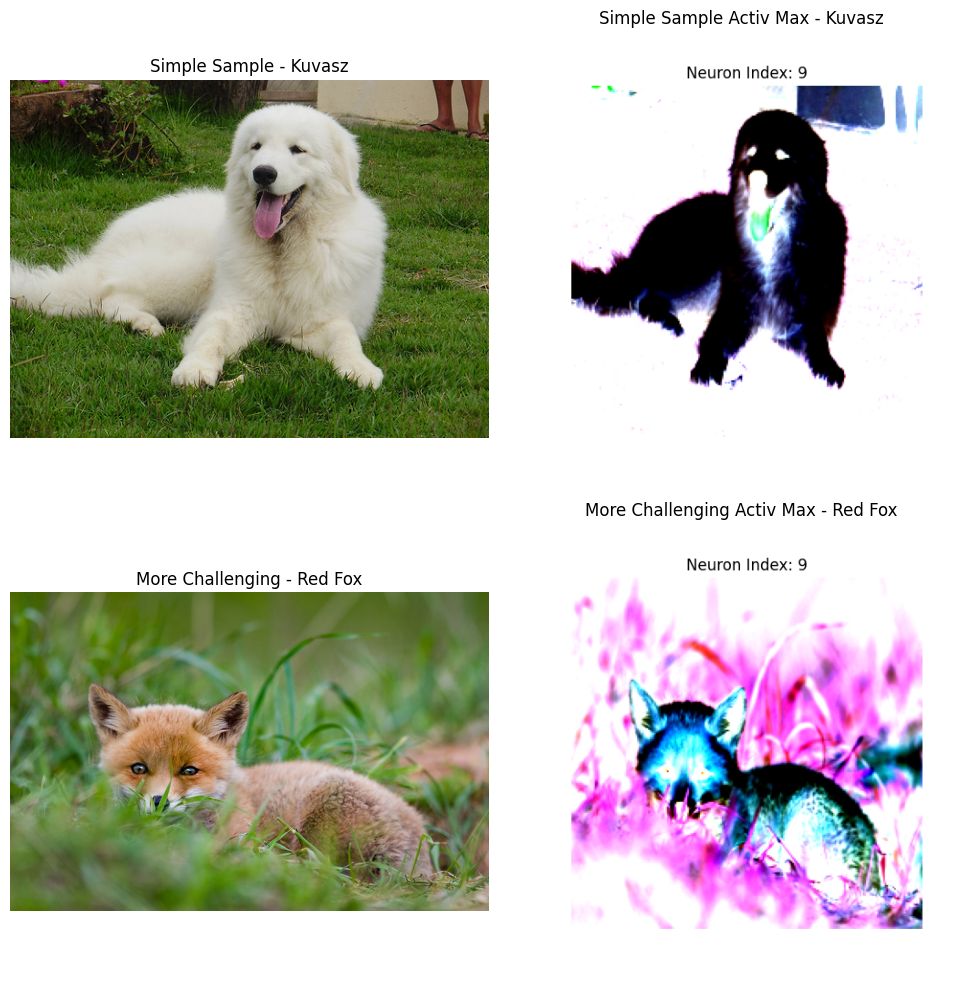

In [10]:
# File paths for the images
image_paths = [
    '/content/drive/MyDrive/Colab/YOLO/animals/simpler sample/222_kuvasz.jpeg',
    '/content/drive/MyDrive/Colab/YOLO/animals/simpler sample_activ_max/222_kuvasz_activ_max.png',
    '/content/drive/MyDrive/Colab/YOLO/animals/more challenging/277_red_fox.jpeg',
    '/content/drive/MyDrive/Colab/YOLO/animals/more challenging_activ_max/277_red_fox_activ_max.png'
]

# Labels for the images
image_labels = [
    'Simple Sample - Kuvasz',
    'Simple Sample Activ Max - Kuvasz',
    'More Challenging - Red Fox',
    'More Challenging Activ Max - Red Fox'
]

# Plotting the images
plt.figure(figsize=(10, 10))
for i, (img_path, label) in enumerate(zip(image_paths, image_labels)):
    img = Image.open(img_path)
    plt.subplot(2, 2, i + 1)
    plt.imshow(img)
    plt.title(label)
    plt.axis('off')

plt.tight_layout()
plt.show()

## Interpretation of the results

The Activation Maximization method greatly help us to better understand our YOLOv8n model decision-making process. The result of the generated activation-maximized images show us unique pattern in their colors and textures, which are representing different neurons or classes that are activate by the model. The color patterns and textures pattern help us to show how the model recognizes and distinguishes features within its learned representations. We are testing it in 40 images, 20 each from the "simpler sample" and "more challenging" classes, which contain animals, this approch good show us, that our model can reveal our model ability to distinguish fine details. However, some of the "more challenging" classes cointain some images, which bit hard to recognise the animal, for example kuvasz in the snow or panda among the plants. After all, Activation Maximization method clear us that how the YOLOv8n model processes and identifies animal-related features, aiding in understanding its decision-making mechanisms and providing valuable insights into its functionality.

#### Reference:

J. Yosinski, J. Clune, A. Nguyen, T. Fuchs, H. Lipson, "Understanding neural networks through deep visualization," Deep Learning Workshop, 31st International Conference on Machine Learning, Lille, France, 2015. Copyright 2015 by the authors. Available at arXiv:1506.06579 [cs.CV], DOI: 10.48550/arXiv.1506.06579.


Deepak, D. (2023, April 24). CNN Visualization Techniques: Feature Maps, Gradient Ascent. Medium. https://medium.com/@deepeshdeepakdd2/cnn-visualization-techniques-feature-maps-gradient-ascent-aec4f4aaf5bd